juliaファイルの内容をコピーして、一部書き換えたもの。

# インポート

In [1]:
"""
import Pkg
Pkg.add("StatsPlots")
Pkg.add("StatsBase")
Pkg.add("Random")
"""

"import Pkg\nPkg.add(\"StatsPlots\")\nPkg.add(\"StatsBase\")\nPkg.add(\"Random\")\n"

In [2]:
using StatsPlots
using StatsBase
using Random

# 変数定義

In [3]:
J, O, N, Oin, STIME, SEASON = 1000, 10, 5, 1, 60, 5
MAXTIME = STIME*SEASON
OBuffer = O + MAXTIME*Oin
tm, tc, tp = STIME, 1, 2

C, c, G, g, I, i = zeros(OBuffer, J, STIME), zeros(OBuffer, J, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME)
w, W, Ti, Ta, Tv, Tc = zeros(J,STIME), zeros(J, OBuffer, STIME), zeros(J, STIME), zeros(J, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME)
Ph, P, Pf, Pb = zeros(J, OBuffer, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(N, OBuffer, STIME)
S, ITh = zeros(J, N, STIME), zeros(J, STIME)
NLh, NLf, NLb, NLg = zeros(J, STIME), zeros(OBuffer, STIME), zeros(N, STIME), zeros(STIME)
p, pe, pf = zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(N, STIME)
eh, e, eb, Δeh, Δe, Δeb = zeros(OBuffer, J, STIME), zeros(OBuffer, STIME), zeros(OBuffer, N, STIME), zeros(OBuffer, J, STIME), zeros(OBuffer, STIME), zeros(OBuffer, N, STIME)
Eh, E, Eb = zeros(OBuffer, J, STIME), zeros(OBuffer, STIME), zeros(OBuffer, N, STIME)
Fh, F, f, fh, Δfh = zeros(N, J, STIME), zeros(N, STIME), zeros(N, STIME), zeros(N, J, STIME), zeros(N, J, STIME)
Mh, Mf, M, ΔMh, ΔMf, ΔM = zeros(N, J, STIME), zeros(N, OBuffer, STIME), zeros(N, STIME), zeros(N, J, STIME), zeros(N, OBuffer, STIME), zeros(N, STIME)
Lh, Lf, L, ΔLh, ΔLf, ΔL = zeros(J, N, STIME), zeros(OBuffer, N, STIME), zeros(N, STIME), zeros(J, N, STIME), zeros(OBuffer, N, STIME), zeros(N, STIME)
H, ΔH = zeros(N, STIME), zeros(N, STIME)
K, k = zeros(OBuffer, STIME), zeros(OBuffer, STIME)
DE, DF = zeros(STIME), zeros(STIME)
NWh, NWf, NWb, NWg, NW = zeros(J, STIME), zeros(OBuffer, STIME), zeros(N, STIME), zeros(STIME), zeros(STIME)
u, v, A, uw = zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME), zeros(OBuffer, STIME)
ΔZb, ΔZh, ΔZf = zeros(N, STIME), zeros(J, STIME), zeros(OBuffer, STIME)

EMP = zeros(Int64, J,STIME)
G_calc_item, G_potential, GDemand = ones(O), ones(O), zeros(MAXTIME)
os = [o for o=1:O]
last_os = [deepcopy(os)]
UER = zeros(STIME)
next_o = O+1

rL = 0.03
GDemand[1] = 1.0*J
uT = 0.8

α1, α2, α3, α4 = 0.9, 0.03, 0.5, 0.01
β1, β2, β3, β4, β5 = 0.02, 0.001, 0.02, 1.0, 0.7
γ1, γ2 = 1.0, 0.3
δ = 0.05
ϵ1, ϵ2, ϵ3 = 1.0, 1.0, 0.1
λ1, λ2, λ3, λ4, λ5, λ6, λ7, λ8, λ9, λ10 = 0.3, 1.0, 0.5, 5.0, 0.5, 1.0, 0.1, 0.3, 0.8, 0.5
τ1, τ2, τ3, τ4 = 0.2, 0.02, 0.1, 0.2
μ1, μ2 = 0.0, 0.05
ν1, ν2, ν3 = 0.35, 0.5, 1.0
θ1, θ2 = 0.2, 0.02
ϕ1, ϕ2 = 0.8, 1.0   # ϕ1<1-θ2
ψ1, ψ2, ψ3, ψ4 = 0.05, 1.0, 0.001, 0.1
ζ1, ζ2, ζ3, ζ4, ζ5 = 0.05, β1+0.02, β1+0.30, 0.7, 0.002
ξ1, ξ2 = 0.05, 0.05
χ1, χ2 = 0.2, 0.7

(0.2, 0.7)

# 関数定義

In [4]:

function G_func(t)
    global G, G_calc_item, G_potential, GDemand
    if t > 1
        GDemand[t] = GDemand[t-1]*(1+β1)
    end
    G_calc_item .*= 1.0 .- β2 .+ β3*randn(O)
    G_calc_item = max.(1.0, G_calc_item)
    if t == 1
        G_potential = max.(0.0, G_calc_item .- β4)
    else
        G_potential = max.(0.0, G_calc_item .- β4) .* k[os,tm].^β5
    end
    if sum(G_potential)==0.0
        G_potential[sample(1:O)] = 1.0
    end
    G[os,tc] = G_potential.*GDemand[t]/sum(G_potential)
end

function c_func()
    global c
    # 消費先を変える場合どこに変えるか、の確率を決める
    r = zeros(O)
    for (q, o) in enumerate(os)
        if q==1
            r[1] = sum(c[os,:,tm])+sum(g[os,tm])
        else
            r[q] = sum(c[os,:,tm])+sum(g[os,tm]) + r[q-1]
        end
    end
    r /= r[end]
    # 消費額を計算
    Cs = (α1*(dropdims(sum(W[:,os,tm], dims=2);dims=2)-Ta[:,tc]-Ti[:,tc]-rL*dropdims(sum(Lh[:,:,tm], dims=2);dims=2)+ITh[:,tm]+dropdims(sum(Ph[:,os,tm], dims=2);dims=2)+dropdims(sum(S[:,:,tm], dims=2);dims=2)) 
        + α2*(dropdims(sum(Eh[os,:,tm], dims=1);dims=1)+dropdims(sum(Mh[:,:,tm], dims=1);dims=1)-dropdims(sum(Lh[:,:,tm], dims=2);dims=2)))
    Cs = max.(Cs, α4*sum(C[:,:,tm])/J)
    if tc==2
        Cs = max.(Cs, α4)
    end
    # 消費先の企業を選ぶ
    p_mean = sum(p[os,tm].*(dropdims(sum(c[os,:,tm],dims=2);dims=2) + g[os,tm]))./(sum(c[os,:,tm]) + sum(g[os,tm]))
    for j=1:J
        # 前期の消費先の特定
        last_o = findall(x -> x > 0.0, c[:,j,tm])[1]
        # 消費先変更するかどうかの決定
        trans = rand() < α3*(p[last_o,tc]-p_mean)/p_mean
        if !(last_o in os)
            trans = true
        end
        # 消費先の選択
        if trans # 変更する場合
            new_o = os[1+searchsortedlast(r, rand())]
            c[new_o,j,tc] = Cs[j]/p[new_o,tc]
        else # 前回と同じ消費先を選ぶ場合
            c[last_o,j,tc] = Cs[j]/p[last_o,tc]
        end
    end
end

function appli_j(j, prob, appli)
    if prob[end] == 0.0 # 募集がなければパス
        return
    end
    # 応募先を割り振る
    q = 1+searchsortedlast(prob, rand())
    push!(appli[q], j)
end

function w_and_W_func(flotation_info)    # wとWの関数の分離を検討
    global w, W, EMP, v
    flotations_js = [info[2] for info in flotation_info]
    # 求人数を作る
    offers = [Int64(round(max(0, (uw[o,tm]*k[o,tm]-A[o,tm]*sum(EMP[:,tm].==o))/A[o,tm]))) for o in os]
    # 応募確率を作る
    prob = zeros(O)
    for q in 1:O
        if q==1
            prob[1] = offers[1]
        else
            prob[q] = prob[q-1] + offers[q]
        end
    end
    if prob[end] > 0.0
        prob /= prob[end]
    end
    # 応募先リストの箱を用意
    appli = [[] for _ = 1:O]
    for j=1:J
        if EMP[j,tm] > 0 # 前期就業していた人
            if !(EMP[j,tm] in os)  # 勤め先が倒産した場合
                if rand() < ζ4
                    appli_j(j, prob, appli) # 応募先を割り振る
                end
            elseif rand() < ζ1 # 今期失業する場合
                W[j,EMP[j,tm],tc] = v[EMP[j,tm],tm]*w[j,tm]
                if rand() < ζ4
                    appli_j(j, prob, appli) # 応募先を割り振る
                end
            else # 今期も同じ企業で就業する場合
                EMP[j,tc] = EMP[j,tm]
                w[j,tc] = w[j,tm]*(1+ζ2*abs(randn()))
                W[j,EMP[j,tm],tc] = v[EMP[j,tm],tm]*w[j,tm]
            end
        elseif j in flotations_js # 起業メンバー
            EMP[j,tc] = EMP[j,tm]
            w[j,tc] = w[j,tm]*(1+ζ2*abs(randn()))
        else # 前期失業していた人
            appli_j(j, prob, appli) # 応募先を割り振る
        end
    end
    # マッチング
    for q=1:O
        if (offers[q] > 0) & (length(appli[q]) > 0)
            much = collect(Set(sample(appli[q], offers[q])))
            for j in much
                EMP[j,tc] = os[q]
                w[j,tc] = w[j,tm]*(1+ζ2*abs(randn()))
            end
        end
    end

    # 従業員が0になった企業を倒産させる
    s = Set(EMP[:,tc])
    q = 1
    while q <= length(os)
        o = os[q]
        if !(o in s)
            bankruptcy(tm,o,q)
        else
            q += 1
        end
    end

    # 失業者の要求賃金率を下げる
    for j=1:J
        if EMP[j,tc]==0
            w[j,tc] = w[j,tm]*abs(1-ζ3*abs(randn()))
        end
    end

    # 要求賃金率の平均への回帰の傾向をつける
    w[:,tc] = (1-ζ5)*w[:,tc] .+ ζ5*mean(w[:,tc])
end

function Lh_func(with_flo_os)
    global Lh
    tmp = -(dropdims(sum(Mh[:,:,tm],dims=1);dims=1) .+ NLh[:,tc] 
            .- [sum(pe[with_flo_os,tm].*Δeh[with_flo_os,j,tc]) for j=1:J] .- [sum(pf[:,tm].*Δfh[:,j,tc]) for j=1:J])
    tmp[tmp .< 0.0] .*= 1.0 - ϵ3 # 支払いのための預金が足りるとき
    tmp[tmp .> 0.0] .*= 1.0 + ϵ3 # 預金が不足するとき
    Lhs = max.(0.0, ϵ1*NLh[:,tc] + ϵ2*dropdims(sum(C[with_flo_os,:,tc], dims=1);dims=1), dropdims(sum(Lh[:,:,tm],dims=2);dims=2)+tmp)
    for j=1:J
        for n=1:N
            if Mh[n,j,tm] > 0.0
                Lh[j,n,tc] = Lhs[j]
                break
            end
        end
    end
end

function ΔLf_and_Lf_func(FRL)
    global ΔLf, Lf
    ΔLfs = max.(-dropdims(sum(Lf[os,:,tm], dims=2);dims=2), FRL)
    for (q,o) in enumerate(os)
        nLf, nMf = findfirst(x -> x > 0.0, Lf[o,:,tm]), findfirst(x -> x > 0.0, Mf[:,o,tm])
        if (nLf == nMf) | (nLf == nothing)
            Lf[o,nMf,tc] = Lf[o,nMf,tm] + ΔLfs[q]
            ΔLf[o,nMf,tc] = ΔLfs[q]
        else
            Lf[o,nMf,tc] = Lf[o,nLf,tm] + ΔLfs[q]
            ΔLf[o,nMf,tc] = Lf[o,nLf,tm] + ΔLfs[q]
            ΔLf[o,nLf,tc] = -Lf[o,nLf,tm]
        end
    end
end

function household_portfolio_func(o_j_value_n_info)
    global Eh, Fh
    # 起業する企業の株式を除く、金融資産額の推定
    Vs = max.(0.0, 
            -dropdims(sum(Lh[:,:,tm],dims=2);dims=2)
            +dropdims(sum(Mh[:,:,tm], dims=1);dims=1)
            +dropdims(sum(Eh[os,:,tm], dims=1);dims=1)
            +dropdims(sum(Fh[:,:,tm], dims=1);dims=1)
            +NLh[:,tc])
    for (o,j,value,n) in o_j_value_n_info
        Vs[j] -= value
    end
    # ポートフォリオ配分先の確率の重みの共通部分を計算
    index = ψ1*(dropdims(sum(Mf[:,os,tm], dims=1);dims=1)-dropdims(sum(Lf[os,:,tm], dims=2);dims=2))+ψ2*(P[os,tc]-Pf[os,tc])
    append!(index, +ψ2*dropdims(sum(S[:,:,tc], dims=1);dims=1))
    index = max.(zeros(O+N), index)
    index /= sum(index)
    # ポートフォリオ配分先の数Int64(x[j])を決めるための準備。
    x = max.(0.0, 1.0*(Vs.-1.0*mean(sum(C[os,:,tc], dims=1)))./mean(sum(C[os,:,tc], dims=1)))
    # 家計jのポートフォリオ計算
    for j=1:J
        lastEhFhSum = sum(Eh[os,j,tm])+sum(Fh[:,j,tm])
        # ポートフォリオ配分先に選ぶ確率の重み付けを決める
        tmp = Eh[os,j,tm]
        append!(tmp, Fh[:,j,tm])
        prob = index
        if lastEhFhSum !== 0.0
            prob = index + tmp/(lastEhFhSum)
        end
        prob /= sum(prob)
        # ポートフォリオ配分先のリストを作る
        lst = sample(1:(O+N), Weights(prob), Int64(round(x[j])))
        if length(lst)==0
            continue
        end
        # 収益率から、資産に占める株式の割合の目標を計算し、保有額を決める
        EF_volume = Vs[j]*λ1
        if (lastEhFhSum!==0.0) & (tc>2)
            EF_volume = Vs[j]*min(λ9, (λ1 + λ2*(sum(Ph[j,os,tc])+sum(S[j,:,tc]))/(lastEhFhSum)))
        end
        # EF_volume/length(lst)を単位としてlstの企業または銀行の株の保有割合を決める
        for on in lst
            if on <= O
                Eh[os[on],j,tc] += EF_volume/length(lst)
            else
                Fh[on-O,j,tc] += EF_volume/length(lst)
            end
        end
        # 起業する企業の株式保有高を計算
        for (o,j,value, n) in o_j_value_n_info
            Eh[o,j,tc] = value
        end
    end
end

function Eb_func()
    global Eb
    # ポートフォリオ配分先の確率の重みの共通部分を計算
    index = ψ1*(dropdims(sum(Mf[:,os,tm], dims=1);dims=1)-dropdims(sum(Lf[os,:,tm], dims=2);dims=2)) + ψ2*(P[os,tc]-Pf[os,tc])
    index = max.(0.0, index)
    index .+= ψ3*mean(index)
    index /= sum(index)
    # 銀行nのポートフォリオ計算
    for n=1:N
        # ポートフォリオ配分割合を決める
        prob = index.*abs.(1.0.+ψ4*randn(O)) + Eb[os,n,tm]/(sum(Eb[os,n,tm]))
        prob /= sum(prob)
        # 収益率から、保有する株式の総額目標を決定
        E_volume = (sum(Eb[os,n,tm])+NLb[n,tc])*(1.0-rL.+λ6*(sum(Pb[n,os,tc])/sum(Eb[os,n,tm]).-rL))
        # ポートフォリオ決定
        Eb[os,n,tc] = E_volume*prob
    end
end

function ΔMh_and_Mh_func(with_flo_os)
    global ΔMh, Mh
    change = rand(J) .< ξ1
    prob = max.(zeros(N), NWb[:,tm])
    if prob[end]==0.0
        change .= false
    else
        prob /= sum(prob)
    end
    for j=1:J
        ΔMh_sum = NLh[j,tc]-sum(pe[with_flo_os,tm].*Δeh[with_flo_os,j,tc])-sum(pf[:,tm].*Δfh[:,j,tc])+sum(ΔLh[j,:,tc])
        last_n = 0
        for n=1:N
            if Mh[n,j,tm] > 0.0
                last_n = n
                break
            end
        end
        if change[j]
            new_n = sample(1:N, Weights(prob))
            Mh[new_n,j,tc] = Mh[last_n,j,tm] + ΔMh_sum
            ΔMh[new_n,j,tc] = Mh[last_n,j,tm] + ΔMh_sum
            ΔMh[last_n,j,tc] -= Mh[last_n,j,tm]
        else
            Mh[last_n,j,tc] = Mh[last_n,j,tm] + ΔMh_sum
            ΔMh[last_n,j,tc] = ΔMh_sum
        end
    end
end

function ΔMf_and_Mf_func(o_j_value_n_info, os_adds)
    global ΔMf, Mf
    change = rand(O) .< ξ2
    prob = max.(zeros(N), NWb[:,tm])
    if prob[end]==0.0
        change .= false
    else
        prob /= sum(prob)
    end
    for (x, o) in enumerate(os)
        ΔMf_sum = NLf[o,tc]+sum(ΔLf[o,:,tc])+pe[o,tm].*Δe[o,tc]
        last_n = 0
        if o in os
            for n=1:N
                if Mf[n,o,tm] > 0.0
                    last_n = n
                    break
                end
            end
        else    # 起業した企業
            for (new_o,j,value,n) in o_j_value_n_info
                if new_o==o
                    last_n = n
                    break
                end
            end
        end
        if change[x]
            new_n = sample(1:N, Weights(prob))
            Mf[new_n,o,tc] = Mf[last_n,o,tm] + ΔMf_sum
            ΔMf[new_n,o,tc] = Mf[last_n,o,tm] + ΔMf_sum
            ΔMf[last_n,o,tc] -= Mf[last_n,o,tm]
        else
            Mf[last_n,o,tc] = Mf[last_n,o,tm] + ΔMf_sum
            ΔMf[last_n,o,tc] = ΔMf_sum
        end
    end
    for o in os_adds
        Mf[:,o,tc] = ΔMf[:,o,tc]
    end
end

function suply_line()
    global g, c, i, G, v, u, uw
    for o in os
        if u[o,tc]>1.0
            G[o,tc] /= u[o,tc]
            g[o,tc] /= u[o,tc]
            c[o,:,tc] ./= u[o,tc]
            i[o,tc] /= u[o,tc]
            v[o,tc] /= u[o,tc]
            u[o,tc] = 1.0
        end
        uw[o,tc] = u[o,tc]
        if v[o,tc] > 1.5
            G[o,tc] *= 1.5/v[o,tc]
            g[o,tc] *= 1.5/v[o,tc]
            c[o,:,tc] .*= 1.5/v[o,tc]
            i[o,tc] *= 1.5/v[o,tc]
            u[o,tc] *= 1.5/v[o,tc]
            v[o,tc] = 1.5
        end
    end
end

function bankruptcy(t, o, q)
    global os, EMP, G_calc_item, G_potential, O
    global ΔMf, ΔLf, Δe, Δeh, Δeb
    global ΔZb, ΔZh, ΔZf
    setdiff!(os, o)
    deleteat!(G_calc_item, q)
    deleteat!(G_potential, q)
    EMP[EMP[:,t].==o, t] .= 0
    if t<MAXTIME
        tp1 = 1+(t-1+1)%STIME
        nMf = findall(x -> x > 0.0, Mf[:,o,t])[1]
        nLf = findall(x -> x > 0.0, Lf[o,:,t])
        if length(nLf)==0
            nLf = nMf
        else
            nLf = nLf[1]
        end
        ΔMf[nMf,o,tp1] = -Mf[nMf,o,t]
        ΔLf[o,nLf,tp1] = -Lf[o,nLf,t]
        Δe[o,tp1] = -e[o,t]
        Δeh[o,:,tp1] = -eh[o,:,t]
        Δeb[o,:,tp1] = -eb[o,:,t]
        ΔZf[o,tp1] = pe[o,t]*Δe[o,tp1] - ΔMf[nMf,o,tp1] + ΔLf[o,nLf,tp1]
        ΔZb[nMf,tp1] += ΔMf[nMf,o,tp1]
        ΔZb[nLf,tp1] -= ΔLf[o,nLf,tp1]
        ΔZb[:,tp1] -= pe[o,t]*Δeb[o,:,tp1]
        ΔZh[:,tp1] -= pe[o,t]*Δeh[o,:,tp1]
    end
    O -= 1
end

function fund_shortage_bankruptcy()
    q = 1
    while length(os) >= q
        o = os[q]
        if (sum(Mf[:,o,tc])<ϕ2*sum(Lf[o,:,tc])) & (P[o,tc]-I[o,tc]<0.0)
            bankruptcy(tc,o,q)
        else
            q += 1
        end
    end
end

function flotation() # 起業
    global G_calc_item, G_potential
    global ΔMh, ΔMf
    global Δe, Δeh
    global k, pe, p, A
    global next_o
    flotation_info, o_j_value_n_info, os_adds = [], [], []
    prob = max.(0.0, NWh[:, tm])
    prob /= sum(prob)
    floation_count = min(Oin, sum(EMP[:,tc].==0.0))
    capitalists_js = sample(1:J, Weights(prob), floation_count, replace=false)
    workers_js = sample(findall(x -> x == 0, EMP[:,tc]), floation_count, replace=false)
    p_mean = sum(p[os,tm].*(dropdims(sum(c[os,:,tm],dims=2);dims=2) + g[os,tm]))./(sum(c[os,:,tm]) + sum(g[os,tm]))
    for (x, o) in enumerate(next_o:next_o+floation_count-1)
        work_j = workers_js[x]
        cap_j = capitalists_js[x]

        # 技術水準の選定
        Awaight = dropdims(sum(c[os,:,tc],dims=2);dims=2).+g[os,tc]
        A[o,tc] = sample(A[os,tm], Weights(Awaight))

        # 従業員情報更新
        EMP[work_j,tc] = o

        # 企業情報リストに追加
        push!(flotation_info, [cap_j, work_j, o])
        
        # 必要なストックの初期状態の定義
        cap_Mf = 0.0
        for n=1:N
            if Mh[n,cap_j,tm] > 0.0
                # 企業の預金増加に伴う変化
                cap_Mf = min(λ10*Mh[n,cap_j,tm], p_mean*2.0*A[o,tc])
                ΔMf[n,o,tc] = cap_Mf   # 資本家と企業が同じ銀行に口座を持つこととする

                # 投資した家計の情報を追加
                push!(o_j_value_n_info, (o, cap_j, cap_Mf, n))
                break
            end
        end
        # 資本家が株を持つことに伴う変化
        pe[o,tm:tc] .= 1.0
        Δe[o,tc] = cap_Mf
        Δeh[o,cap_j,tc] = cap_Mf
        # 企業が価格のつかない資本を持つことに伴う変化
        k[o,tc] = cap_Mf/p_mean

        # 生存企業のリストにIDを追加
        push!(os_adds, o)
    end
    next_o += floation_count
    # 政府支出受注額決定のための配列を更新
    append!(G_calc_item, [1.0 for _=1:floation_count])
    append!(G_potential, [0.0 for _=1:floation_count])

    return flotation_info, o_j_value_n_info, os_adds
end

function clear_tp2()
    global EMP, UER
    global C, c, G, g, I, i
    global w, W, Ti, Ta, Tv, Tc
    global Ph, P, Pf, Pb, S, ITh
    global NLh, NLf, NLb, NLg
    global p, pe, pf
    global eh, e, eb, Δeh, Δe, Δeb
    global Eh, E, Eb
    global Fh, F, f, fh, Δfh
    global Mh, Mf, M, ΔMh, ΔMf, ΔM
    global Lh, Lf, L, ΔLh, ΔLf, ΔL
    global H, ΔH, K, k, DE, DF
    global NWh, NWf, NWb, NWg, NW
    global u, v, A, uw
    global ΔZb, ΔZh, ΔZf

    tp2 = 1+(tc-1+2)%STIME

    EMP[:,tp2], UER[tp2] = zeros(Int64, J), 0.0
    C[:,:,tp2], c[:,:,tp2], G[:,tp2], g[:,tp2], I[:,tp2], i[:,tp2] = zeros(OBuffer, J), zeros(OBuffer, J), zeros(OBuffer), zeros(OBuffer), zeros(OBuffer), zeros(OBuffer)
    w[:,tp2], W[:,:,tp2], Ti[:,tp2], Ta[:,tp2], Tv[:,tp2], Tc[:,tp2] = zeros(J), zeros(J, OBuffer), zeros(J), zeros(J), zeros(OBuffer), zeros(OBuffer)
    Ph[:,:,tp2], P[:,tp2], Pf[:,tp2], Pb[:,:,tp2], S[:,:,tp2], ITh[:,tp2] = zeros(J, OBuffer), zeros(OBuffer), zeros(OBuffer), zeros(N, OBuffer), zeros(J, N), zeros(J)
    NLh[:,tp2], NLf[:,tp2], NLb[:,tp2], NLg[tp2] = zeros(J), zeros(OBuffer), zeros(N), 0.0
    p[:,tp2], pe[:,tp2], pf[:,tp2] = zeros(OBuffer), zeros(OBuffer), zeros(N)
    eh[:,:,tp2], e[:,tp2], eb[:,:,tp2], Δeh[:,:,tp2], Δe[:,tp2], Δeb[:,:,tp2] = zeros(OBuffer, J), zeros(OBuffer), zeros(OBuffer, N), zeros(OBuffer, J), zeros(OBuffer), zeros(OBuffer, N)
    Eh[:,:,tp2], E[:,tp2], Eb[:,:,tp2] = zeros(OBuffer, J), zeros(OBuffer), zeros(OBuffer, N)
    Fh[:,:,tp2], F[:,tp2], f[:,tp2], fh[:,:,tp2], Δfh[:,:,tp2] = zeros(N, J), zeros(N), zeros(N), zeros(N, J), zeros(N, J)
    Mh[:,:,tp2], Mf[:,:,tp2], M[:,tp2], ΔMh[:,:,tp2], ΔMf[:,:,tp2], ΔM[:,tp2] = zeros(N, J), zeros(N, OBuffer), zeros(N), zeros(N, J), zeros(N, OBuffer), zeros(N)
    Lh[:,:,tp2], Lf[:,:,tp2], L[:,tp2], ΔLh[:,:,tp2], ΔLf[:,:,tp2], ΔL[:,tp2] = zeros(J, N), zeros(OBuffer, N), zeros(N), zeros(J, N), zeros(OBuffer, N), zeros(N)
    H[:,tp2], ΔH[:,tp2] = zeros(N), zeros(N)
    K[:,tp2], k[:,tp2] = zeros(OBuffer), zeros(OBuffer)
    DE[tp2], DF[tp2] = 0.0, 0.0
    NWh[:,tp2], NWf[:,tp2], NWb[:,tp2], NWg[tp2], NW[tp2] = zeros(J), zeros(OBuffer), zeros(N), 0.0, 0.0
    u[:,tp2], v[:,tp2], A[:,tp2], uw[:,tp2] = zeros(OBuffer), zeros(OBuffer), zeros(OBuffer), zeros(OBuffer)
    ΔZb[:,tp2], ΔZh[:,tp2], ΔZf[:,tp2] = zeros(N), zeros(J), zeros(OBuffer)
end

function one_season(TIMERANGE)
    global p, pe, pf
    global Ti, Ta, Tv, Tc, w, W
    global g, G, c, C, i, I
    global k, K
    global P, Ph, Pf, Pb, S, ITh
    global A, u, DE, DF
    global NLh, NLf, NLb, NLg
    global Lh, Lf, L, ΔLh, ΔLf, ΔL
    global Mh, Mf, M, ΔMh, ΔMf, ΔM
    global eh, eb, e, Δeh, Δeb, Δe, Eh, Eb, E
    global fh, f, Δfh, Δf, Fh, F
    global H, ΔH
    global NWh, NWf, NWb, NWg, NW
    global last_os, O, UER
    global tc, tm, tp

    print("#")
    flotation_info = []
    for t=TIMERANGE
        #println("##################### t=",t," ######################")
        tc, tm, tp = 1+(t-1)%STIME, 1+(t-1-1)%STIME, 1+(t-1+1)%STIME

        p_mean = sum(p[os,tm].*(dropdims(sum(c[os,:,tm],dims=2);dims=2) + g[os,tm]))./(sum(c[os,:,tm]) + sum(g[os,tm]))
        p[os,tc] = ν2*(1.0+ν1.+ν3.*(i[os,tm]./(uT*γ1*k[os,tm]))).*(dropdims(sum(W[:,os,tm], dims=1);dims=1)+Tv[os,tm]+Tc[os,tm]+rL*dropdims(sum(Lf[os,:,tm],dims=2);dims=2)+δ*k[os,tm])./(uT*γ1*k[os,tm]).+(1-ν2)*p_mean
        w_and_W_func(flotation_info)
        Ti[:,tc] = τ1*(dropdims(sum(W[:,os,tm], dims=2);dims=2)+dropdims(sum(Ph[:,os,tm], dims=2);dims=2)+dropdims(sum(S[:,:,tm], dims=2);dims=2))
        Ta[:,tc] = max.(0.0, τ2*(dropdims(sum(Eh[os,:,tm], dims=1);dims=1)+dropdims(sum(Fh[:,:,tm], dims=1);dims=1)+dropdims(sum(Mh[:,:,tm], dims=1);dims=1)-dropdims(sum(Lh[:,:,tm], dims=2);dims=2)))
        Tv[os,tc] = τ3*(dropdims(sum(C[os,:,tm], dims=2);dims=2)+I[os,tm]+G[os,tm])
        Tc[os,tc] = max.(0.0, τ4*P[os,tm])
        G_func(t)
        g[os,tc] = G[os,tc]./p[os,tc]
        c_func()
        i[os,tc] = max.(0.0, min.(δ*k[os,tm]+(u[os,tm].-uT).*γ1.*k[os,tm], γ2*(dropdims(sum(Mf[:,os,tm], dims=1);dims=1)-dropdims(sum(Lf[os,:,tm], dims=2);dims=2))./p[os,tc]))
        u[os,tc] = (dropdims(sum(c[os,:,tc], dims=2);dims=2)+i[os,tc]+g[os,tc])./(γ1*k[os,tm])
        A[os,tc] = A[os,tm].*(1+μ1.+μ2*i[os,tm]./k[os,tm])
        for o in os
            v[o,tc] = (u[o,tc]*k[o,tm])./(A[o,tc]*sum(EMP[:,tc].==o))
        end
        suply_line()
        for o in os
            C[o,:,tc] = p[o,tc]*c[o,:,tc]
        end
        I[os,tc] = p[os,tc].*i[os,tc]
        k[os,tc] = (1-δ).*k[os,tm]+i[os,tc]
        K[os,tc] = p[os,tc].*k[os,tc]
        ITh[:,tc] = χ1*(sum(C[:,:,tm])+sum(G[:,tm]))/J .+ χ2*(EMP[:,tm].==0)*sum(C[:,:,tm])/J
        P[os,tc] = dropdims(sum(C[os,:,tc], dims=2);dims=2)+G[os,tc]+I[os,tc]-dropdims(sum(W[:,os,tc], dims=1);dims=1)-Tv[os,tc]-Tc[os,tc]-rL*dropdims(sum(Lf[os,:,tm], dims=2);dims=2)
        for o in os
            Ph[:,o,tc] = max(0.0, θ1*(P[o,tc]-I[o,tc])+θ2*(sum(Mf[:,o,tm])-sum(Lf[o,:,tm]))).*eh[o,:,tm]./e[o,tm]
            Pb[:,o,tc] = max(0.0, θ1*(P[o,tc]-I[o,tc])+θ2*(sum(Mf[:,o,tm])-sum(Lf[o,:,tm]))).*eb[o,:,tm]./e[o,tm]
        end
        Pf[os,tc] = P[os,tc] - dropdims(sum(Ph[:,os,tc], dims=1);dims=1) - dropdims(sum(Pb[:,os,tc], dims=1);dims=1)
        for n=1:N
            S[:,n,tc] = max.(0.0, θ1*(rL*L[n,tm]+sum(Pb[n,os,tc]))+θ2*sum(Eb[os,n,tm])).*fh[n,:,tm]/f[n,tm]
        end
        NLh[:,tc] = -dropdims(sum(C[os,:,tc], dims=1);dims=1) + dropdims(sum(W[:,os,tc], dims=2);dims=2)-Ti[:,tc]-Ta[:,tc]-rL*dropdims(sum(Lh[:,:,tm], dims=2);dims=2)+ITh[:,tc]+dropdims(sum(Ph[:,os,tc], dims=2);dims=2)+dropdims(sum(S[:,:,tc], dims=2);dims=2)
        NLf[os,tc] = -I[os,tc] + Pf[os,tc]
        NLb[:,tc] = rL*(dropdims(sum(Lh[:,:,tm],dims=1);dims=1).+dropdims(sum(Lf[os,:,tm],dims=1);dims=1)) + dropdims(sum(Pb[:,os,tc], dims=2);dims=2) - dropdims(sum(S[:,:,tc], dims=1);dims=1)
        NLg[tc] = -sum(G[os,tc])+sum(Ti[:,tc])+sum(Ta[:,tc])+sum(Tv[os,tc])+sum(Tc[os,tc])-sum(ITh[:,tc])
        flotation_info, o_j_value_n_info, os_adds = flotation()   # 起業
        with_flo_os = cat(os, os_adds, dims=1)
        FR = dropdims(sum(W[:,os,tc], dims=1);dims=1)+Tv[os,tc]+Tc[os,tc]+rL*dropdims(sum(Lf[os,:,tm], dims=2);dims=2)-ϕ1*dropdims(sum(Mf[:,os,tm], dims=1);dims=1)
        Δe[os,tc] = min.(max.(-λ7*e[os,tm], (λ3.+λ4*(rL.-(P[os,tc]-Pf[os,tc])./(dropdims(sum(Eh[os,:,tm], dims=2);dims=2)+dropdims(sum(Eb[os,:,tm], dims=2);dims=2)))).*FR./pe[os,tm]), λ8*e[os,tm])
        ΔLf_and_Lf_func(FR.-pe[os,tm].*Δe[os,tc])
        E[:,tc] = E[:,tm] + pe[:,tm].*Δe[:,tc]
        e[:,tc] = e[:,tm] + Δe[:,tc]
        household_portfolio_func(o_j_value_n_info)
        f[:,tc] = f[:,tm]
        F[:,tc] = F[:,tm]
		pf[:,tc] = dropdims(sum(Fh[:,:,tc], dims=2);dims=2)./f[:,tc]
        for j=1:J
            fh[:,j,tc] = Fh[:,j,tc]./pf[:,tc]
        end
        Δfh[:,:,tc] = fh[:,:,tc] .- fh[:,:,tm]
        Eb_func()
        pe[with_flo_os,tc] = (dropdims(sum(Eh[with_flo_os,:,tc], dims=2);dims=2)+dropdims(sum(Eb[with_flo_os,:,tc], dims=2);dims=2))./e[with_flo_os,tc]
        for j=1:J
            eh[with_flo_os,j,tc] = Eh[with_flo_os,j,tc]./pe[with_flo_os,tc]
        end
        for n=1:N
            eb[os,n,tc] = Eb[os,n,tc]./pe[os,tc]
        end
        Δeh[with_flo_os,:,tc] = eh[with_flo_os,:,tc] - eh[with_flo_os,:,tm]
        Δeb[os,:,tc] = eb[os,:,tc] - eb[os,:,tm]
        Lh_func(with_flo_os)
        ΔLh[:,:,tc] = Lh[:,:,tc] - Lh[:,:,tm]
        L[:,tc] = dropdims(sum(Lh[:,:,tc], dims=1);dims=1) + dropdims(sum(Lf[:,:,tc], dims=1);dims=1)
        ΔL[:,tc] = dropdims(sum(ΔLh[:,:,tc],dims=1);dims=1) + dropdims(sum(ΔLf[:,:,tc],dims=1);dims=1)
        ΔMh_and_Mh_func(with_flo_os)
        ΔMf_and_Mf_func(o_j_value_n_info, os_adds)
        M[:,tc] = dropdims(sum(Mh[:,:,tc], dims=2);dims=2)+dropdims(sum(Mf[:,:,tc], dims=2);dims=2)
        ΔM[:,tc] = dropdims(sum(ΔMh[:,:,tc],dims=2);dims=2) + dropdims(sum(ΔMf[:,:,tc],dims=2);dims=2)
        ΔH[:,tc] = NLb[:,tc]-[sum(pe[:,tm].*Δeb[:,n,tc]) for n=1:N]+ΔM[:,tc]-ΔL[:,tc]-ΔZb[:,tc]
        H[:,tc] = H[:,tm] + ΔH[:,tc]
        NWh[:,tc] = dropdims(sum(Mh[:,:,tc], dims=1);dims=1)-dropdims(sum(Lh[:,:,tc], dims=2);dims=2)+dropdims(sum(Eh[:,:,tc], dims=1);dims=1)+dropdims(sum(Fh[:,:,tc], dims=1);dims=1)
        NWf[:,tc] = K[:,tc]+dropdims(sum(Mf[:,:,tc], dims=1);dims=1)-dropdims(sum(Lf[:,:,tc], dims=2);dims=2)-E[:,tc]
        NWb[:,tc] = -M[:,tc]+L[:,tc]+dropdims(sum(Eb[:,:,tc], dims=1);dims=1)-F[:,tc]+H[:,tc]
        NWg[tc] = -sum(H[:,tc])
        NW[tc] = sum(NWh[:,tc])+sum(NWf[:,tc])+sum(NWb[:,tc])+NWg[tc]
        DE[tc] = -sum(E[:,tc])+sum(Eh[:,:,tc])+sum(Eb[os,:,tc])
        DF[tc] = sum(Fh[:,:,tc])-sum(F[:,tc])
        """
        println("transaction consistency : ",sum(NLh[:,tc])+sum(NLf[:,tc])+sum(NLb[:,tc])+sum(NLg[tc]))
        println("h flow consistency : ",sum(NLh[:,tc])-sum([sum(pe[:,tm].*Δeh[:,j,tc]) for j=1:J])-sum([sum(pf[:,tm].*Δfh[:,j,tc]) for j=1:J])+sum(ΔLh[:,:,tc])-sum(ΔMh[:,:,tc])-sum(ΔZh[:,tc]))
        println("f flow consistency : ",sum(NLf[:,tc])+sum(pe[:,tm].*Δe[:,tc])+sum(ΔLf[:,:,tc])-sum(ΔMf[:,:,tc])-sum(ΔZf[:,tc]))
        println("b flow consistency : ",sum(NLb[:,tc])-sum([sum(pe[:,tm].*Δeb[:,n,tc]) for n=1:N])-sum(ΔL[:,tc])+sum(ΔM[:,tc])-sum(ΔH[:,tc])-sum(ΔZb[:,tc]))
        println("g flow consistency : ",NLg[tc]+sum(ΔH[:,tc]))
        println("stock consistency : ", sum(K[:,tc])+DE[tc]+DF[tc]-NW[tc])
        """
        print("#")
        if t % STIME==0
            println()
        elseif t % 10==0
            print(" ")
        end
        append!(os, os_adds)
        O += length(os_adds)
        push!(last_os, sort(deepcopy(os)))
        fund_shortage_bankruptcy()   # 資金繰りが理由の倒産処理

        UER[tc] = sum(EMP[:,tc].==0)/J

        # t+2 に値を書き込む要素をクリア
        clear_tp2()
    end
    println()
end

# 初期値設定
function initialise()
    global EMP, UER
    global Eh, Eb, E, pe, eh, eb, e
    global Fh, F, f, fh
    global Lh, Lf, L
    global K, k, p, H, A
    global NWh, NWf, NWb, NWg, NW

    for _=1:20
        G_func(1)
    end

    lstj, lsto, lstn = zeros(J), zeros(O), zeros(N)
    lstj[1], lsto[1], lstn[1] = 1.0, 1.0, 1.0
    #* 消費ネットワーク
    for j=1:J
        c[os,j,1] = shuffle(lsto)
    end
    #* 雇用ネットワーク
    EMP[:,1] = rand(0:O,J)
    w[:,1] .= 1.0
    for j=1:J
        if EMP[j,1]!==0
            W[j,EMP[j,1],1] = w[j,1]
        end
    end
    #* 企業株式保有ネットワーク
    for o in os
        Eh[o,:,1] = shuffle(lstj)
    end
    Eb[os,:,1] = rand(O,N)
    DIV = sum(Eh[os,:,1], dims=2)+sum(Eb[os,:,1], dims=2)
    for o in os
        Eh[o,:,1] /= DIV[o]
        Eb[o,:,1] /= DIV[o]
    end
    E[os,1] .= 1.0
    pe[os,1] .= 1.0
    eh[os,:,1], eb[os,:,1], e[os,1] = Eh[os,:,1], Eb[os,:,1], E[os,1]
    #* 銀行株式保有ネットワーク
    Fh[:,:,1] = ones(N,J)
    for j=1:J
        Fh[:,j,1] /= sum(Fh[:,j,1])
    end
    F[:,1] = sum(Fh[:,:,1],dims=2)
    fh[:,:,1] .= 1.0/J
    f[:,1] .= 1.0
    pf[:,1] = F[:,1]./f[:,1]
    #* 預金貸借ネットワーク
    for j=1:J
        Mh[:,j,1] = shuffle(10.0.*lstn)
    end
    for o in os
        Mf[:,o,1] = shuffle(lstn)
    end
    M[:,1] = sum(Mh[:,:,1],dims=2)+sum(Mf[:,:,1],dims=2)
    #* 初期資本と初期価格
    k[os,1] .= J/O
    for o in os
        p[o,1] = (1+ν1)*(sum(W[:,o,1])+δ*k[o,1])/(uT*γ1*k[o,1])
    end
    K[os,1] = p[os,1].*k[os,1]
    A[os,1] .= 1.0
    #* 現金ネットワーク
    H[:,1] .= dropdims(sum(Mh[:,:,1],dims=2);dims=2) + dropdims(sum(Mf[:,:,1],dims=2);dims=2)
                -dropdims(sum(Lh[:,:,1],dims=1);dims=1) - dropdims(sum(Lf[:,:,1],dims=1);dims=1)
    #* ストックの整合性を保証
    NWh[:,1] = dropdims(sum(Mh[:,:,1],dims=1); dims=1)-dropdims(sum(Lh[:,:,1],dims=2);dims=2)+dropdims(sum(Eh[:,:,1],dims=1);dims=1)+dropdims(sum(Fh[:,:,1],dims=1);dims=1)
    NWf[os,1] = K[os,1]+dropdims(sum(Mf[:,os,1],dims=1);dims=1)-dropdims(sum(Lf[os,:,1],dims=2),dims=2)-E[os,1]
    NWb[:,1] = -M[:,1]+L[:,1]+dropdims(sum(Eb[os,:,1],dims=1);dims=1)-F[:,1]+H[:,1]
    NWg[1] = -sum(H[:,1])
    NW[1] = sum(K[:,1])

    UER[1] = sum(EMP[:,1].==0)/J
end


initialise (generic function with 1 method)

# シミュレーション実行

In [5]:
initialise()
testspan = 40
# *バーンイン期間
one_season(2:MAXTIME-testspan-1)
# *パラメータの変化
β1 = 0.0
# * パラメータ変化後のシミュレーション
one_season(MAXTIME-testspan:MAXTIME)

########## ########## ########## ########## ########## ##########
########## ########## ########## ########## ########## ##########
########## ########## ########## ########## ########## ##########
########## ########## ########## ########## ########## ##########
########## #########
## ########## ########## ########## ##########



# プロット

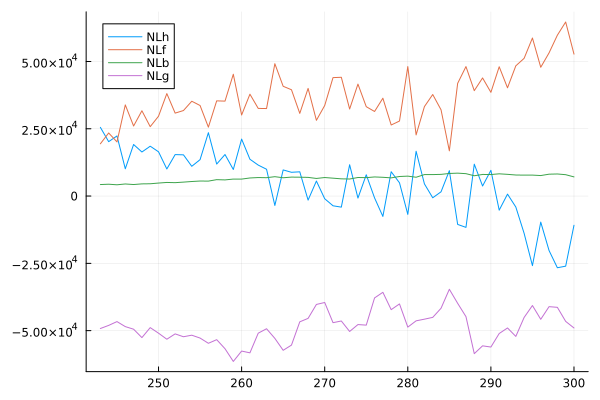

In [6]:
plot(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NLh[:,3:STIME],dims=1);dims=1), label="NLh")
plot!(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NLf[:,3:STIME],dims=1);dims=1), label="NLf")
plot!(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NLb[:,3:STIME],dims=1);dims=1), label="NLb")
plot!(MAXTIME-STIME+1+2:MAXTIME,NLg[3:STIME], label="NLg")

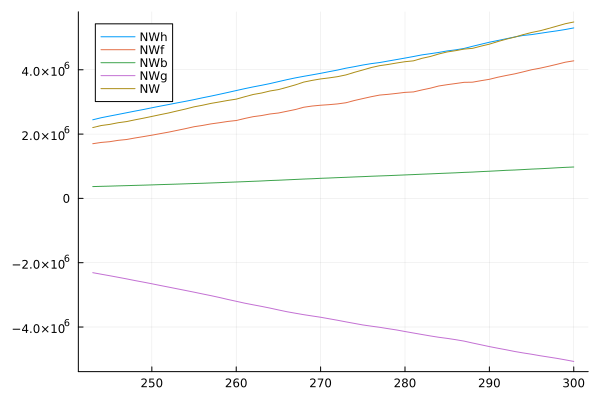

In [7]:
plot(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NWh[:,3:STIME],dims=1);dims=1), label="NWh")
plot!(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NWf[:,3:STIME],dims=1);dims=1), label="NWf")
plot!(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(NWb[:,3:STIME],dims=1);dims=1), label="NWb")
plot!(MAXTIME-STIME+1+2:MAXTIME,NWg[3:STIME], label="NWg")
plot!(MAXTIME-STIME+1+2:MAXTIME,NW[3:STIME], label="NW")

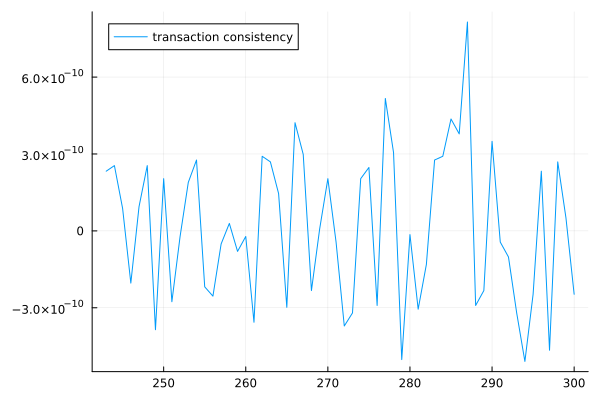

In [8]:
plot(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(NLh[:,3:STIME],dims=1);dims=1).+dropdims(sum(NLf[:,3:STIME],dims=1);dims=1).+dropdims(sum(NLb[:,3:STIME],dims=1);dims=1).+NLg[3:STIME], label="transaction consistency")

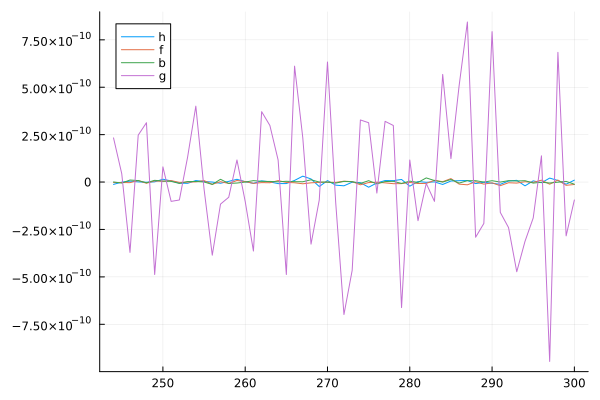

In [9]:
plot(MAXTIME-STIME+1+3:MAXTIME,[sum(NLh[:,t])-sum([sum(pe[:,t-1].*Δeh[:,j,t]) for j=1:J])-sum([sum(pf[:,t-1].*Δfh[:,j,t]) for j=1:J])-sum(ΔMh[:,:,t])+sum(ΔLh[:,:,t])-sum(ΔZh[:,t]) for t=4:STIME],label="h")
plot!(MAXTIME-STIME+1+3:MAXTIME,[sum(NLf[:,t])+sum(pe[:,t-1].*Δe[:,t])+sum(ΔLf[:,:,t])-sum(ΔMf[:,:,t])-sum(ΔZf[:,t]) for t=4:STIME],label="f")
plot!(MAXTIME-STIME+1+3:MAXTIME,[sum(NLb[:,t])-sum([sum(pe[:,t-1].*Δeb[:,n,t]) for n=1:N])-sum(ΔL[:,t])+sum(ΔM[:,t])-sum(ΔH[:,t])-sum(ΔZb[:,t]) for t=4:STIME],label="b")
plot!(MAXTIME-STIME+1+3:MAXTIME,[NLg[t]+sum(ΔH[:,t]) for t=4:STIME],label="g")

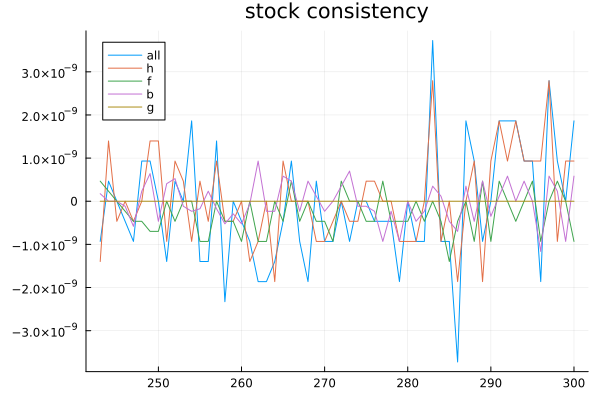

In [10]:
plot(MAXTIME-STIME+1+2:MAXTIME,dropdims(sum(K[:,3:STIME],dims=1);dims=1).+DE[3:STIME].+DF[3:STIME].-NW[3:STIME], label="all", title="stock consistency")
plot!(MAXTIME-STIME+1+2:MAXTIME,[sum(Mh[:,:,t])-sum(Lh[:,:,t])+sum(Eh[:,:,t])+sum(Fh[:,:,t])-sum(NWh[:,t]) for t=3:STIME], label="h")
plot!(MAXTIME-STIME+1+2:MAXTIME,[sum(K[:,t])+sum(Mf[:,:,t])-sum(Lf[:,:,t])-sum(E[:,t])-sum(NWf[:,t]) for t=3:STIME], label="f")
plot!(MAXTIME-STIME+1+2:MAXTIME,[-sum(M[:,t])+sum(L[:,t])+sum(Eb[:,:,t])-sum(F[:,t])+sum(H[:,t])-sum(NWb[:,t]) for t=3:STIME], label="b")
plot!(MAXTIME-STIME+1+2:MAXTIME,[-sum(H[:,t])-NWg[t] for t=3:STIME], label="g")

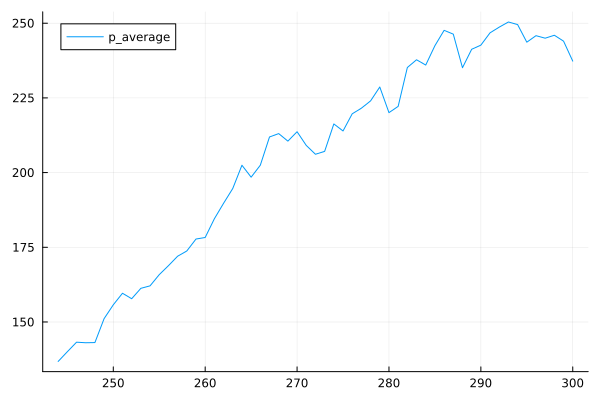

In [11]:
plot(MAXTIME-STIME+1+3:MAXTIME, [dropdims(sum(p[last_os[t],1+(t-1)%STIME],dims=1);dims=1)./length(last_os[t]) for t=MAXTIME-STIME+1+3:MAXTIME], label="p_average")

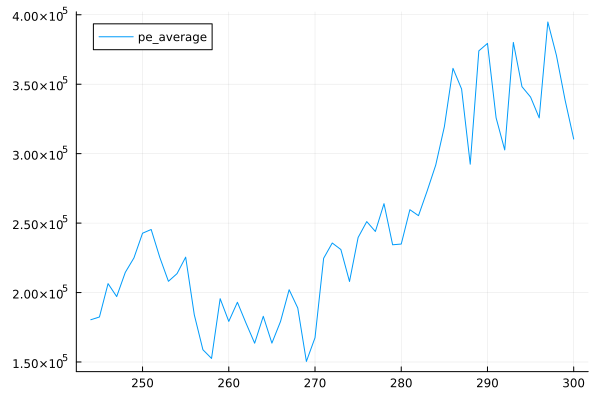

In [12]:
plot(MAXTIME-STIME+1+3:MAXTIME, [dropdims(sum(pe[last_os[t],1+(t-1)%STIME],dims=1);dims=1)./length(last_os[t]) for t=MAXTIME-STIME+1+3:MAXTIME], label="pe_average")

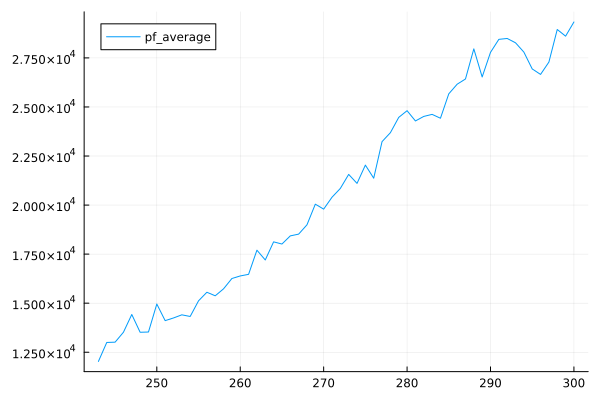

In [13]:
plot(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(pf[:,3:STIME],dims=1);dims=1)./N, label="pf_average")

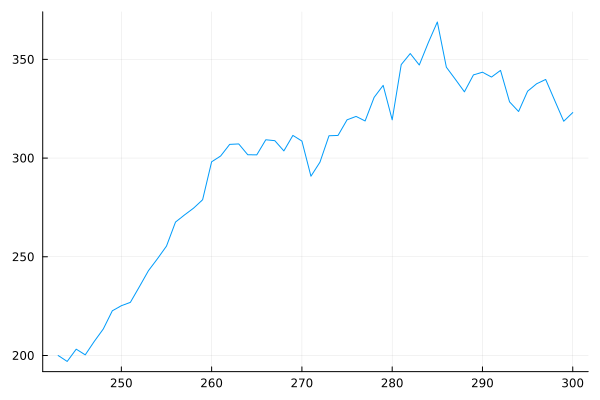

In [14]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(W[:,:,t])/J for t=3:STIME], label=nothing)

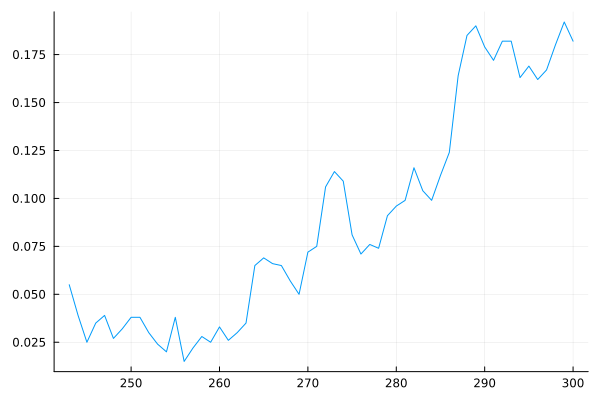

In [15]:
plot(MAXTIME-STIME+1+2:MAXTIME, UER[3:STIME], label=nothing)

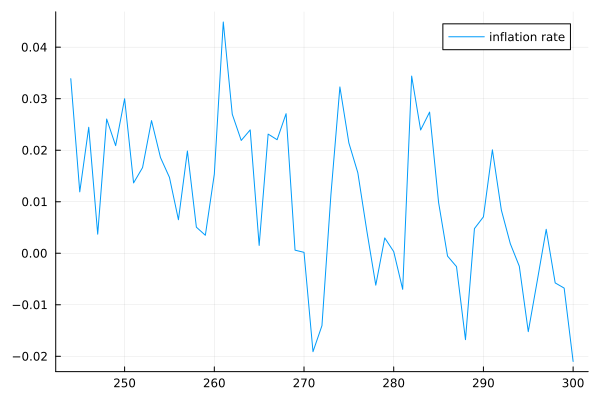

In [16]:
p_means = [(sum(C[:,:,1+(t-1)%STIME])+sum(G[:,1+(t-1)%STIME]))/(sum(c[:,:,1+(t-1)%STIME])+sum(g[:,1+(t-1)%STIME])) for t=1:STIME]
plot(MAXTIME-STIME+1+3:MAXTIME, [p_means[1+(t-1)%STIME]/p_means[1+(t-1-1)%STIME]-1.0 for t=MAXTIME-STIME+1+3:MAXTIME], label="inflation rate")

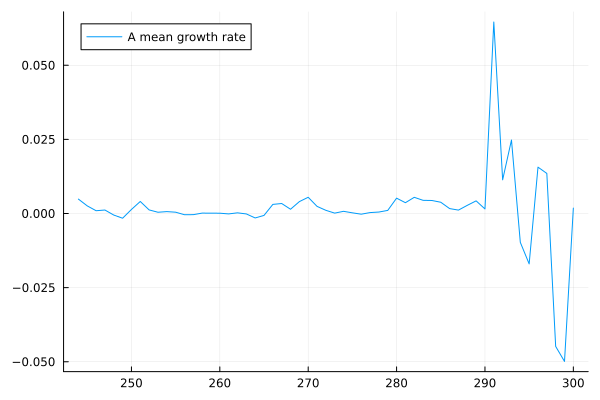

In [17]:
A_means = [sum(A[last_os[1+(t-1)%STIME],1+(t-1)%STIME].*(dropdims(sum(c[last_os[1+(t-1)%STIME],:,1+(t-1)%STIME],dims=2);dims=2)+g[last_os[1+(t-1)%STIME],1+(t-1)%STIME])
            ./(sum(c[last_os[1+(t-1)%STIME],:,1+(t-1)%STIME])+sum(g[last_os[1+(t-1)%STIME],1+(t-1)%STIME]))) for t=1:STIME]
plot(MAXTIME-STIME+1+3:MAXTIME, [A_means[1+(t-1)%STIME]/A_means[1+(t-1-1)%STIME]-1.0 for t=MAXTIME-STIME+1+3:MAXTIME], label="A mean growth rate")

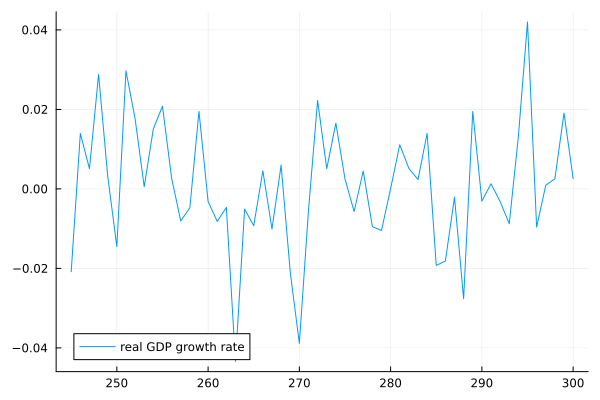

In [18]:
y = [sum(c[last_os[t],:,1+(t-1)%STIME])+sum(g[last_os[t],1+(t-1)%STIME])+sum(i[last_os[t],1+(t-1)%STIME]) for t=MAXTIME-STIME+1+3:MAXTIME]
plot(MAXTIME-STIME+1+4:MAXTIME, y[2:end]./y[1:end-1].-1.0, label="real GDP growth rate")

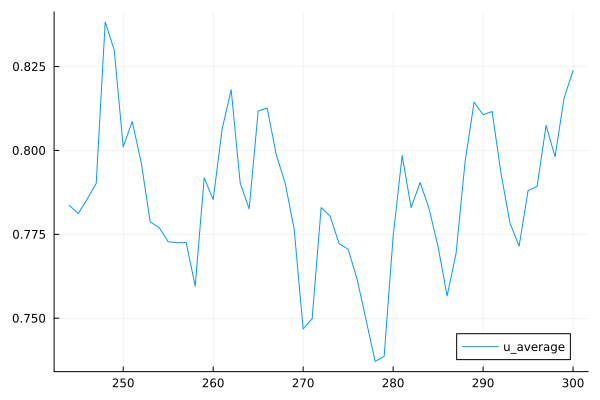

In [19]:
plot(MAXTIME-STIME+1+3:MAXTIME, [sum(u[last_os[t],1+(t-1)%STIME])/length(last_os[t]) for t=MAXTIME-STIME+1+3:MAXTIME], label="u_average")

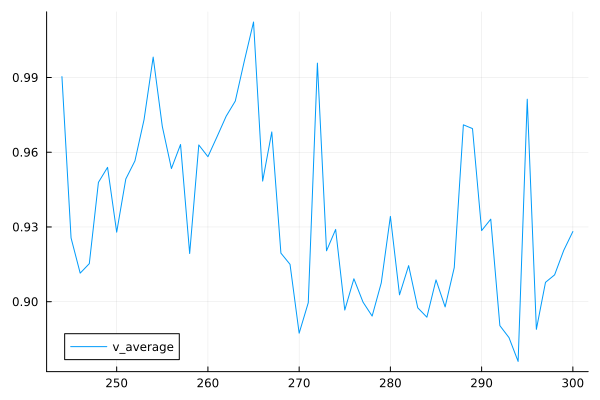

In [20]:
plot(MAXTIME-STIME+1+3:MAXTIME, [sum(v[last_os[t],1+(t-1)%STIME])/length(last_os[t]) for t=MAXTIME-STIME+1+3:MAXTIME], label="v_average")

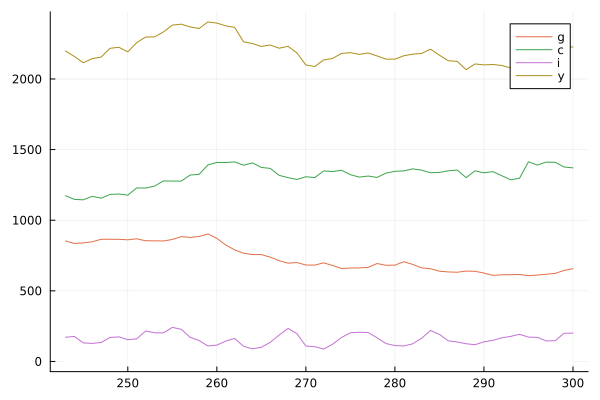

In [21]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(g[:,t]) for t=3:STIME], label="g")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(c[:,:,t]) for t=3:STIME], label="c")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(i[:,t]) for t=3:STIME], label="i")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(g[:,t])+sum(c[:,:,t])+sum(i[:,t]) for t=3:STIME], label="y")

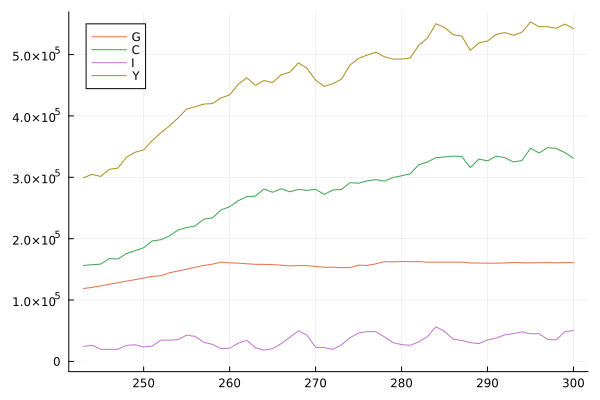

In [22]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(G[:,t]) for t=3:STIME], label="G")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(C[:,:,t]) for t=3:STIME], label="C")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(I[:,t]) for t=3:STIME], label="I")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(G[:,t])+sum(C[:,:,t])+sum(I[:,t]) for t=3:STIME], label="Y")

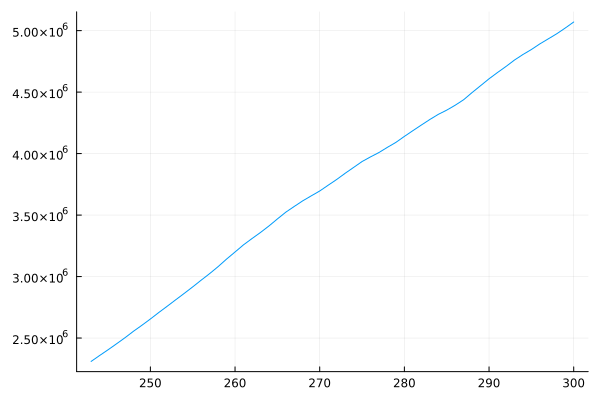

In [23]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(H[:,t]) for t=3:STIME],label=nothing)

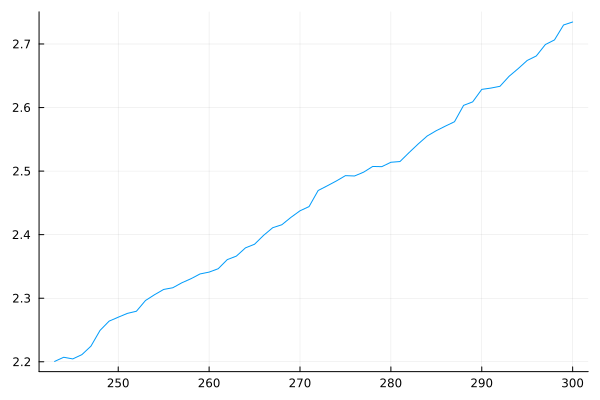

In [24]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(A[last_os[t],1+(t-1)%STIME])/length(last_os[t]) for t=MAXTIME-STIME+1+2:MAXTIME],label=nothing)

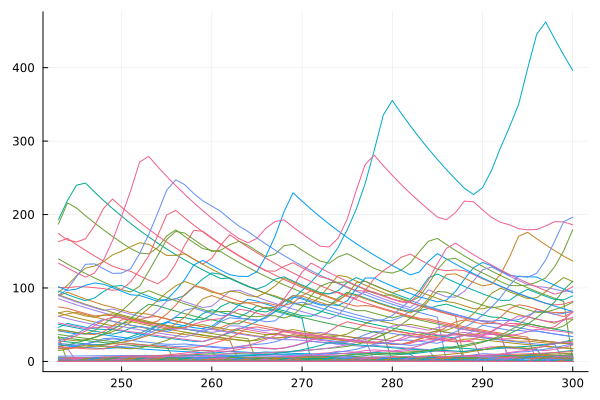

In [25]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o=1:OBuffer
    plot!(MAXTIME-STIME+1+2:MAXTIME, [k[o,t] for t=3:STIME],label=nothing)
end
plot!()

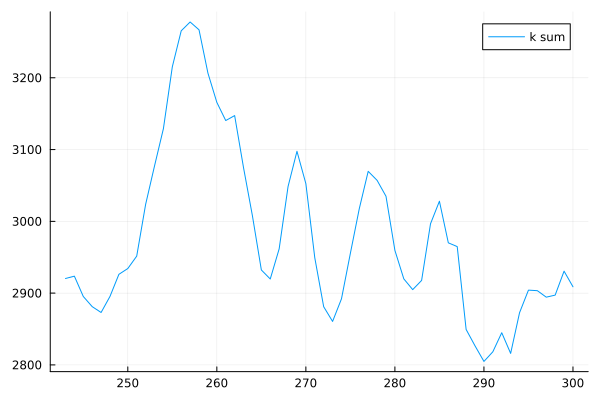

In [26]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(k[:,t]) for t=3:STIME],label="k sum")

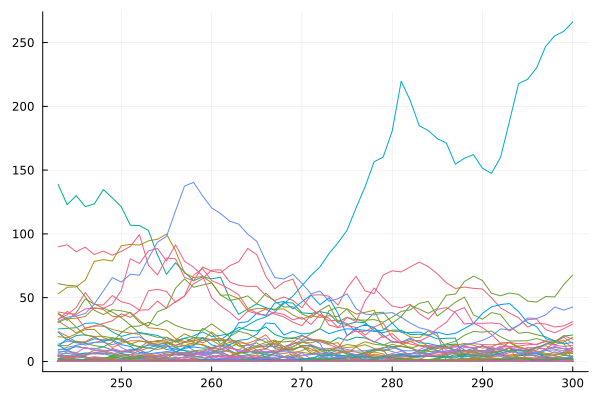

In [27]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o=1:OBuffer
    plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(g[o,t]) for t=3:STIME],label=nothing)
end
plot!()

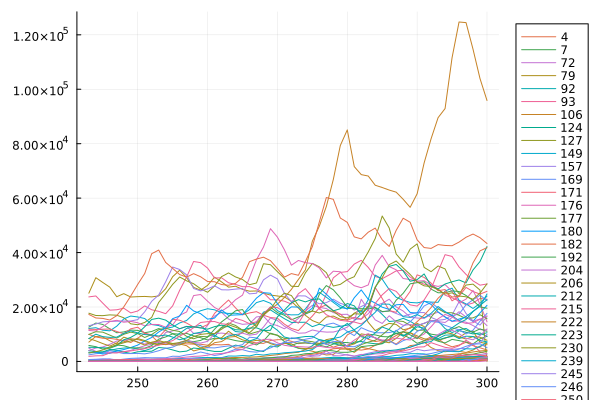

In [28]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, K[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

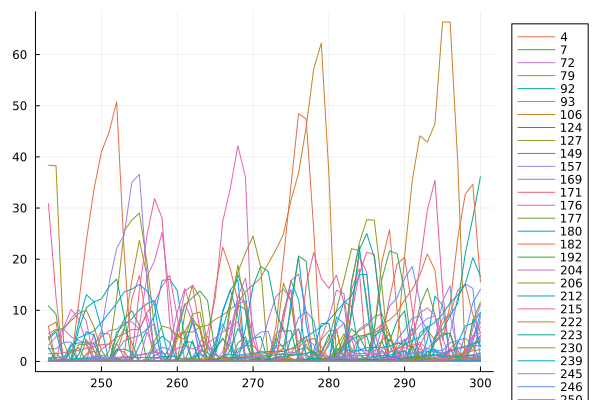

In [29]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, i[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

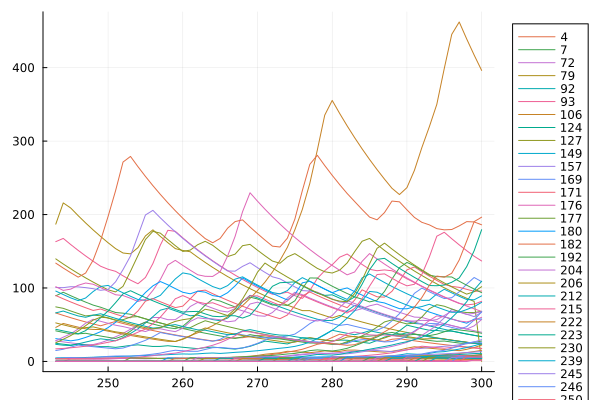

In [30]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, k[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

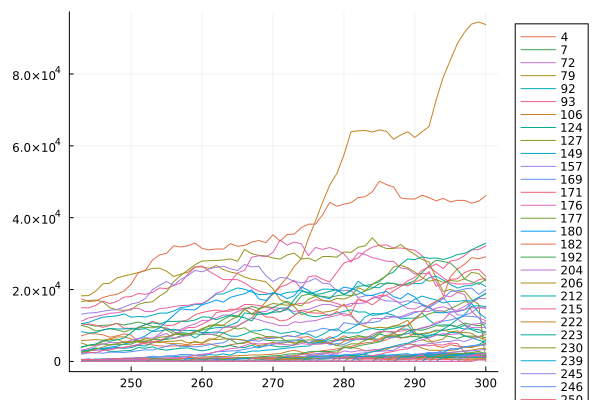

In [31]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Mf[:,o,3:STIME],dims=1);dims=1), label=string(o), legend=:outertopright)
end
plot!()

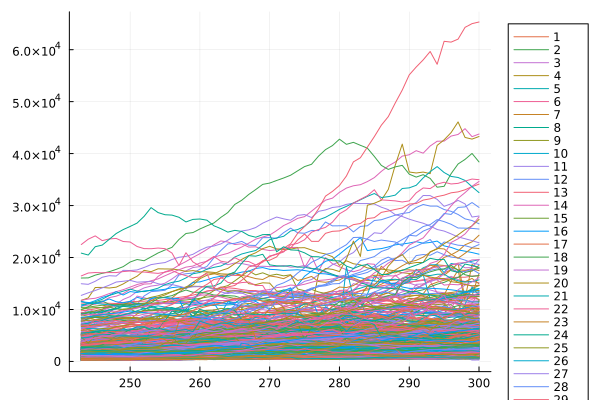

In [32]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for j=1:J
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Mh[:,j,3:STIME],dims=1);dims=1), label=string(j), legend=:outertopright)
end
plot!()

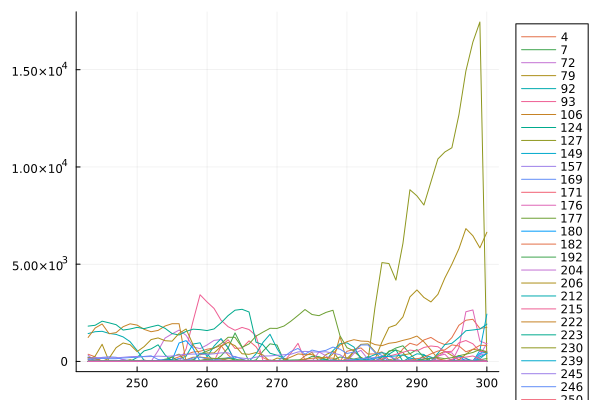

In [33]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Lf[o,:,3:STIME],dims=1);dims=1), label=string(o), legend=:outertopright)
end
plot!()

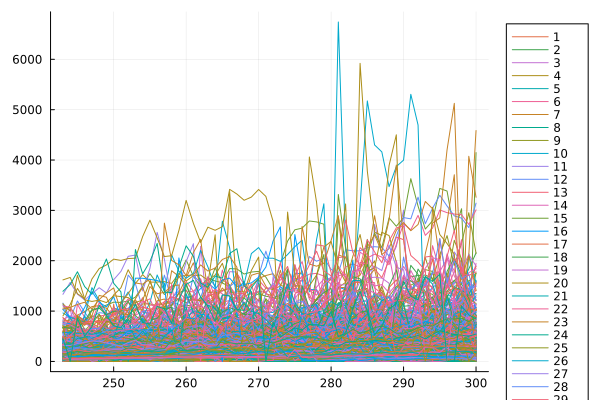

In [34]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for j=1:J
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Lh[j,:,3:STIME],dims=1);dims=1), label=string(j), legend=:outertopright)
end
plot!()

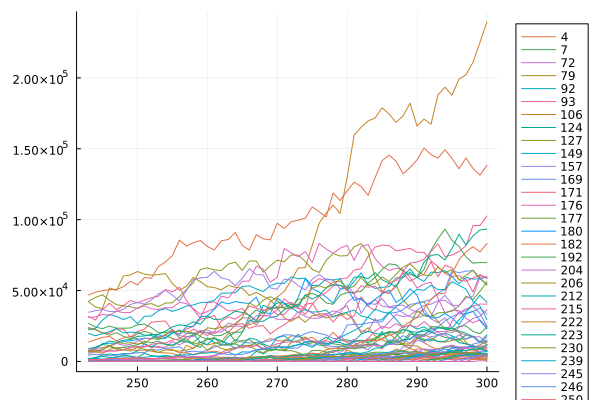

In [35]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Eh[o,:,3:STIME],dims=1);dims=1)+dropdims(sum(Eb[o,:,3:STIME],dims=1);dims=1), label=string(o), legend=:outertopright)
end
plot!()

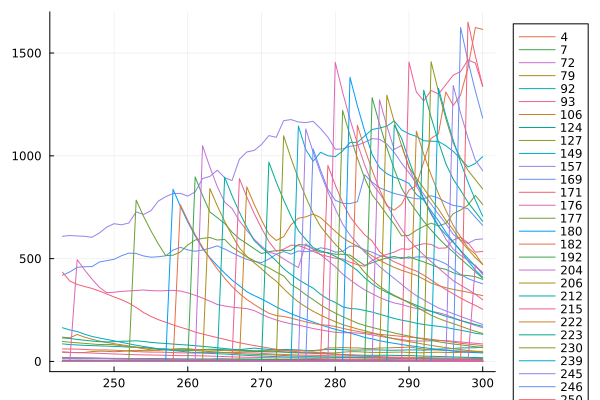

In [36]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, e[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

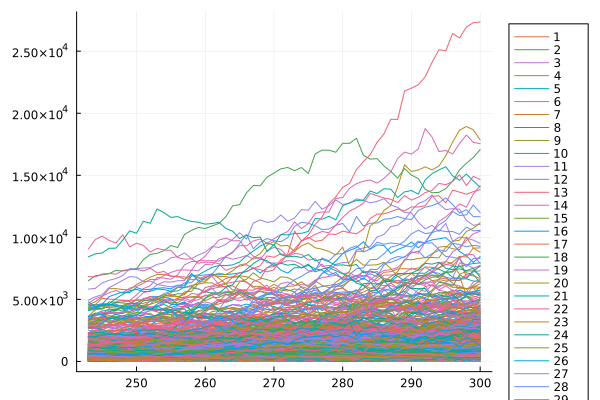

In [37]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for j=1:J
    plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Eh[:,j,t]) for t=3:STIME], label=string(j), legend=:outertopright)
end
plot!()

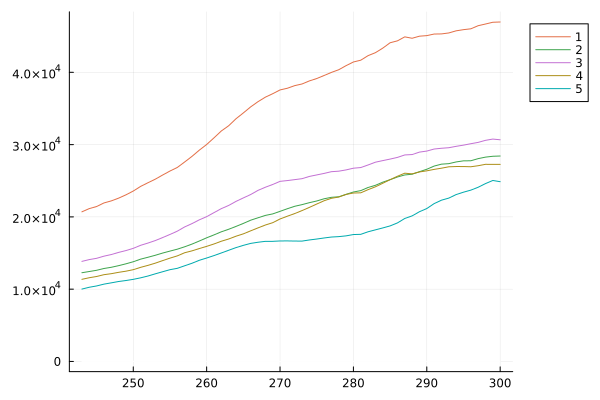

In [38]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for n=1:N
    plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Eb[:,n,t]) for t=3:STIME], label=string(n), legend=:outertopright)
end
plot!()

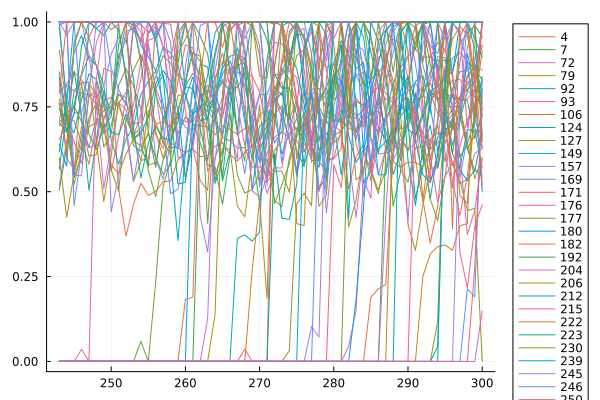

In [39]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, u[o,3:STIME],label=string(o), legend=:outertopright)
end
plot!()

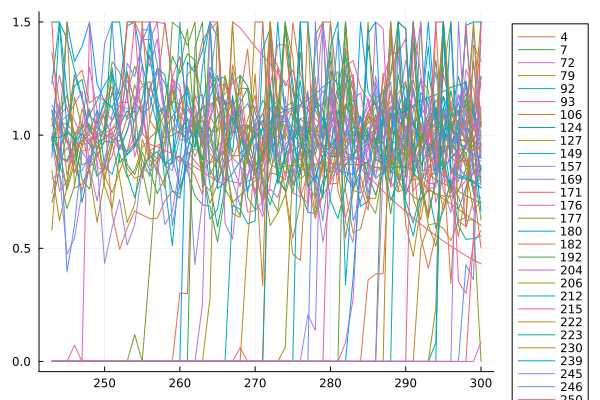

In [40]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, v[o,3:STIME],label=string(o), legend=:outertopright)
end
plot!()

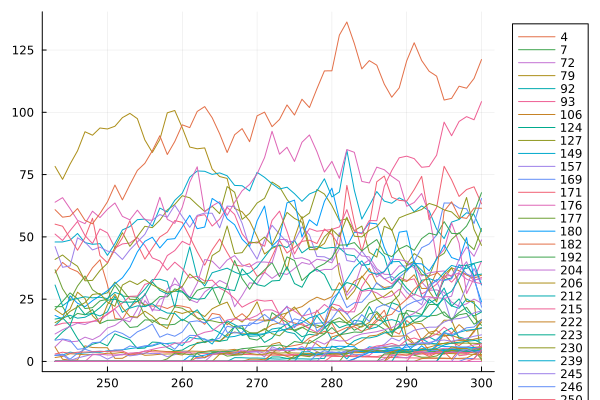

In [41]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(c[o,:,3:STIME],dims=1);dims=1),label=string(o), legend=:outertopright)
end
plot!()

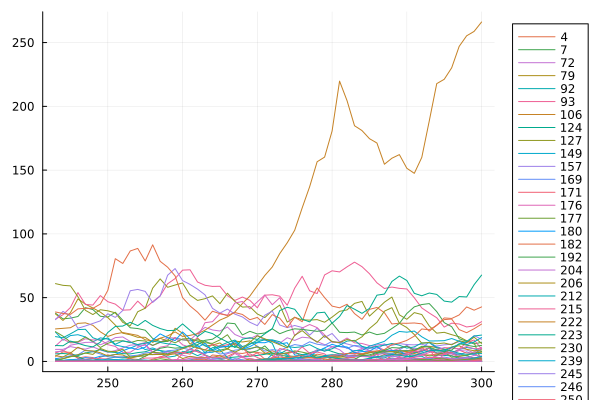

In [42]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, g[o,3:STIME],label=string(o), legend=:outertopright)
end
plot!()

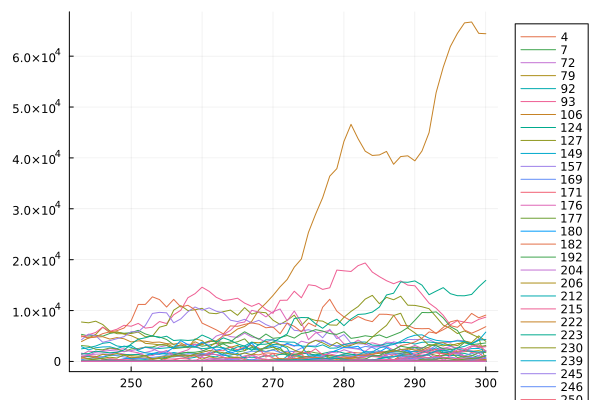

In [43]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, G[o,3:STIME],label=string(o), legend=:outertopright)
end
plot!()

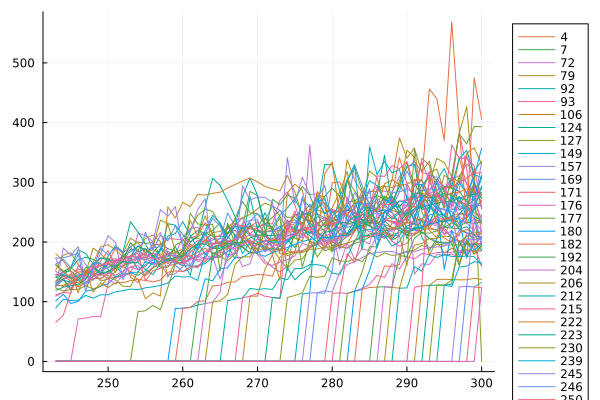

In [44]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, p[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

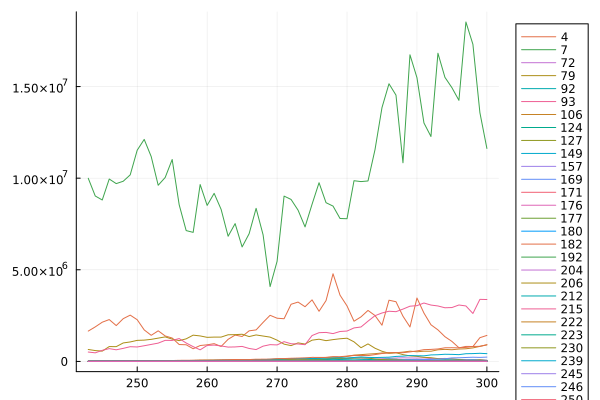

In [45]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, pe[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

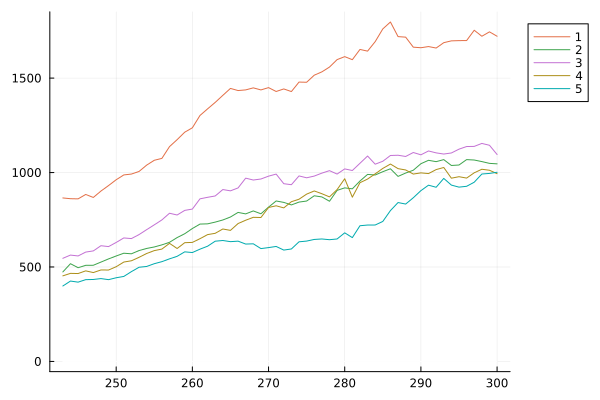

In [46]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for n=1:N
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(S[:,n,3:STIME],dims=1);dims=1), label=string(n), legend=:outertopright)
end
plot!()

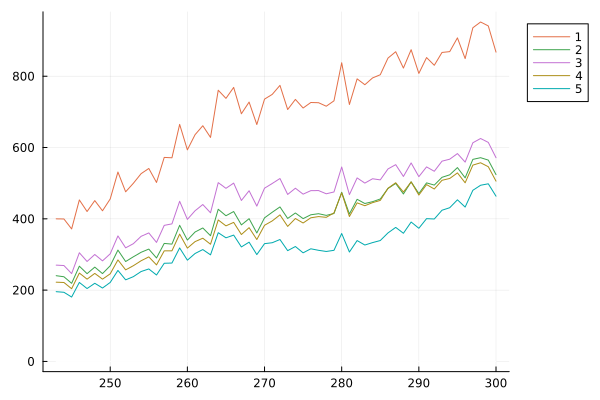

In [47]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for n=1:N
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Pb[n,:,3:STIME],dims=1);dims=1), label=string(n), legend=:outertopright)
end
plot!()

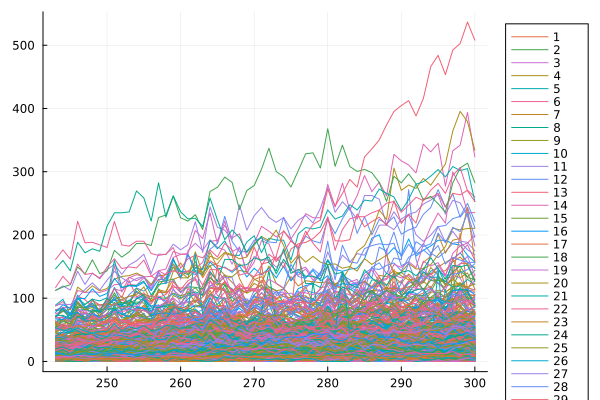

In [48]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for j=1:J
    plot!(MAXTIME-STIME+1+2:MAXTIME, dropdims(sum(Ph[j,:,3:STIME],dims=1);dims=1), label=string(j), legend=:outertopright)
end
plot!()

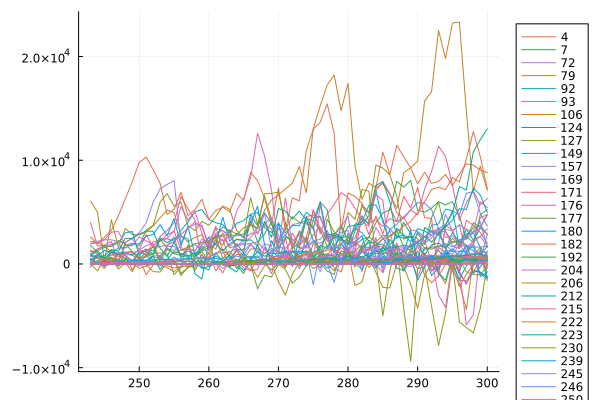

In [49]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, Pf[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

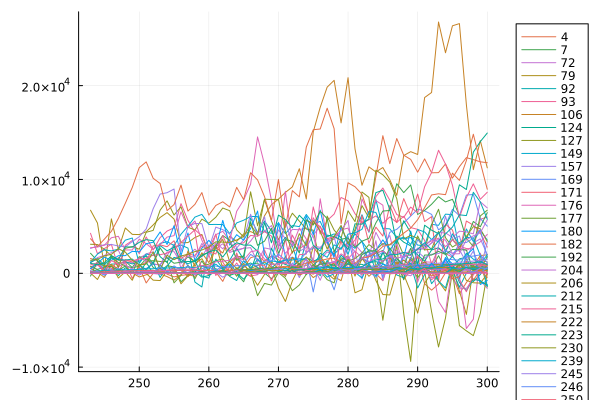

In [50]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, P[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

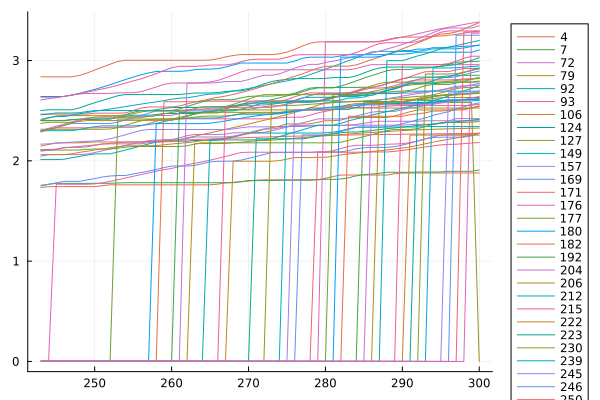

In [51]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o in last_os[end-1]
    plot!(MAXTIME-STIME+1+2:MAXTIME, A[o,3:STIME], label=string(o), legend=:outertopright)
end
plot!()

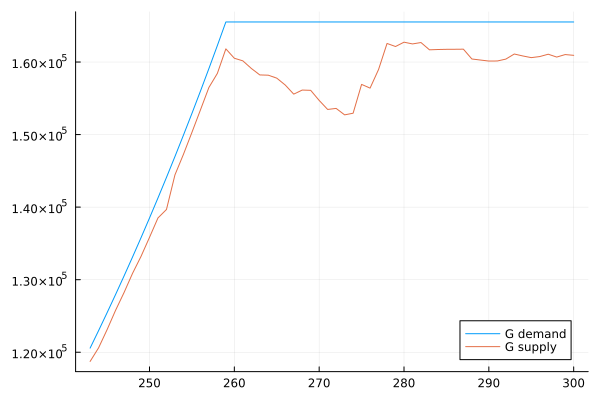

In [52]:
plot(MAXTIME-STIME+1+2:MAXTIME, [GDemand[t] for t=MAXTIME-STIME+1+2:MAXTIME], label="G demand")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(G[:,t]) for t=3:STIME], label="G supply")

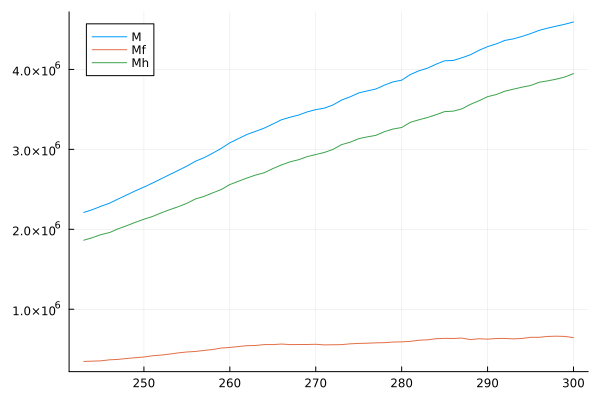

In [53]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(M[:,t]) for t=3:STIME], label="M")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Mf[:,:,t]) for t=3:STIME], label="Mf")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Mh[:,:,t]) for t=3:STIME], label="Mh")

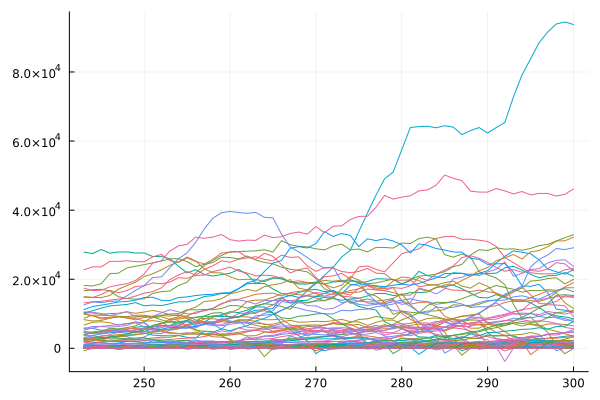

In [54]:
plot(MAXTIME-STIME+1+2:MAXTIME, zeros(STIME-2),label=nothing, color="white")
for o=1:OBuffer
    plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Mf[:,o,t])-sum(Lf[o,:,t]) for t=3:STIME], label=nothing)
end
plot!()

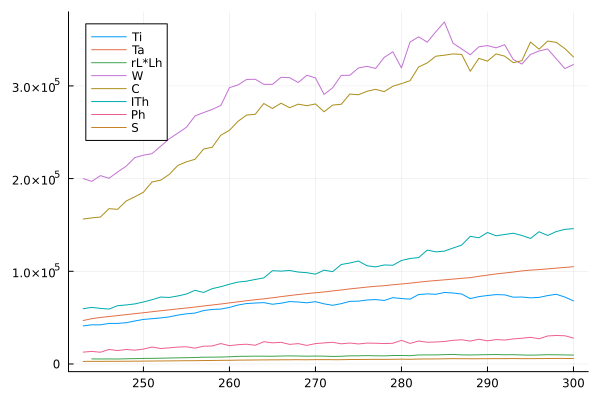

In [55]:
plot(MAXTIME-STIME+1+2:MAXTIME, [sum(Ti[:,t]) for t=3:STIME],label="Ti")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Ta[:,t]) for t=3:STIME],label="Ta")
plot!(MAXTIME-STIME+1+3:MAXTIME, [rL*sum(Lh[:,:,t-1]) for t=4:STIME],label="rL*Lh")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(W[:,:,t]) for t=3:STIME],label="W")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(C[:,:,t]) for t=3:STIME],label="C")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(ITh[:,t]) for t=3:STIME],label="ITh")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(Ph[:,:,t]) for t=3:STIME],label="Ph")
plot!(MAXTIME-STIME+1+2:MAXTIME, [sum(S[:,:,t]) for t=3:STIME],label="S")

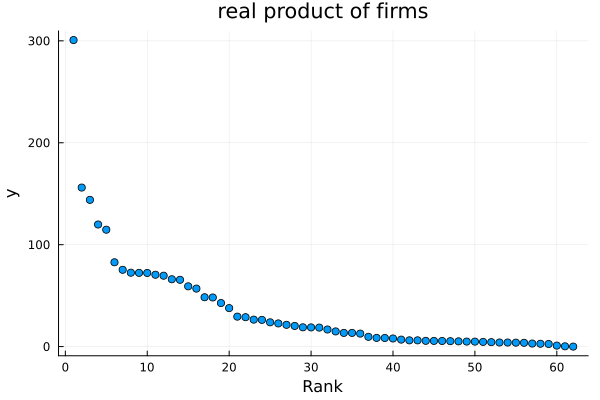

In [56]:
yfs = dropdims(sum(c[last_os[end],:,end],dims=2);dims=2)+g[last_os[end],end]+i[last_os[end],end]
sort!(yfs,rev=true)
scatter(yfs, xlabel="Rank", ylabel="y", title="real product of firms", label=nothing)

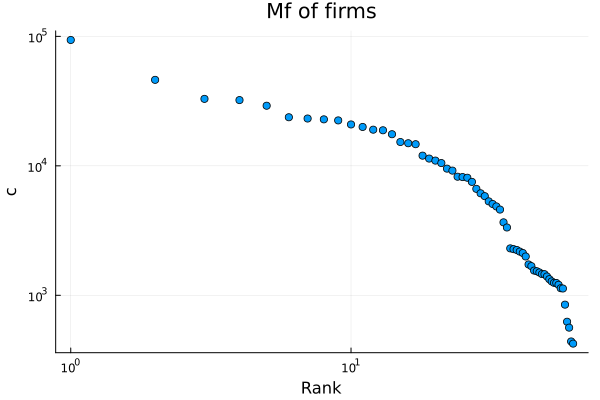

In [57]:
Mfs = dropdims(sum(Mf[:,last_os[end],end],dims=1);dims=1)
sort!(Mfs,rev=true)
scatter(Mfs, xlabel="Rank", ylabel="c", xscale=:log10, yscale=:log10, title="Mf of firms", label=nothing)

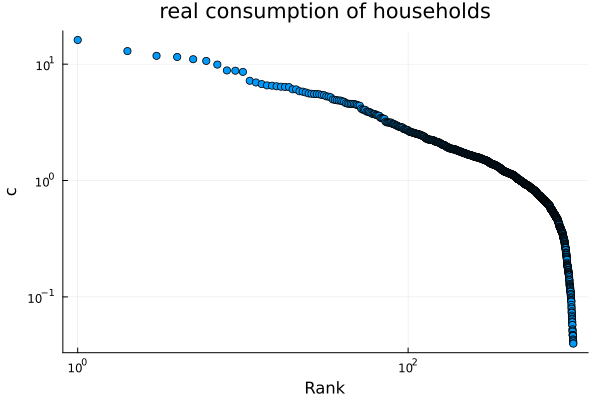

In [58]:
chs = dropdims(sum(c[:,:,end],dims=1);dims=1)
sort!(chs,rev=true)
scatter(chs, xlabel="Rank", ylabel="c", xscale=:log10, yscale=:log10, title="real consumption of households", label=nothing)